# **Breast Histopathology : Invasive Ductal Carcinoma (IDC)**
---

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
import albumentations as A
from pathlib import Path
from collections import Counter
from tqdm.auto import tqdm
tqdm.pandas()
import random

# Whole Slide Visualization

In [2]:
slides = list(Path('/kaggle/input/breast-histopathology-images').glob('*'))
len(slides)

280

In [3]:
def path_parser(p):
    p_id, idx, x, y, label = p.stem.split('_')
    return {
        'path': p,
        'patient_id': p_id,
        'idx': int(idx.replace('idx','')),
        'x': int(x[1:]),
        'y': int(y[1:]),
        'label': int(label.replace('class',''))
    }

def get_slices(slide_path):
    slices = list(slide_path.glob('*/*'))
    slices = map(path_parser, slices)
    slices = list(sorted(slices, key = lambda p:p['x'] + p['y']))
    return slices

def create_slide(slide_path):
    # help from: https://www.kaggle.com/code/allunia/breast-cancer/
    slices = get_slices(slide_path)
    max_x = max([s['x'] for s in slices])
    max_y = max([s['y'] for s in slices])

    slide = np.ones((max_x + 50, max_y + 50, 3)).astype(np.uint8) * 255
    mask = np.ones((max_x + 50, max_y + 50, 3)).astype(np.uint8) * 255
    errors = []
    
    for sl in tqdm(slices):
        
        im = np.array(Image.open(sl['path']).convert('RGB'))
        start_x, start_y = sl['x']-1, sl['y']-1
        end_x, end_y = start_x + 50, start_y + 50
        try:
            slide[start_y:end_y, start_x:end_x] = im
        except ValueError:
            errors.append(sl)
        if sl['label'] == 1:
            mask[start_y:end_y, start_x:end_x, :] = 0
            mask[start_y:end_y, start_x:end_x, 0] = 250
        
    return {
        'slide': slide,
        'mask': mask,
        'errors': errors
    }

In [4]:
def slide_viz(slide):
    fig,ax = plt.subplots(1,1,figsize=(24,24))
    ax.imshow(slide['mask'], alpha=0.8)
    ax.imshow(slide['slide'],alpha=0.7)
    plt.show()

  0%|          | 0/2009 [00:00<?, ?it/s]

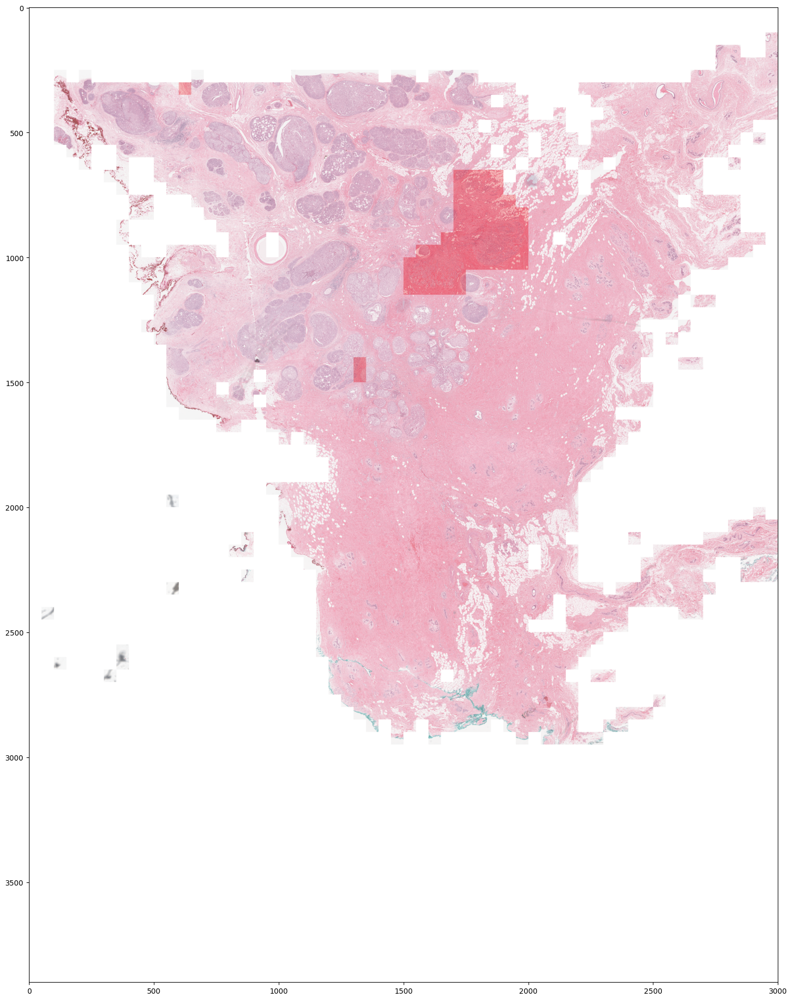

  0%|          | 0/1493 [00:00<?, ?it/s]

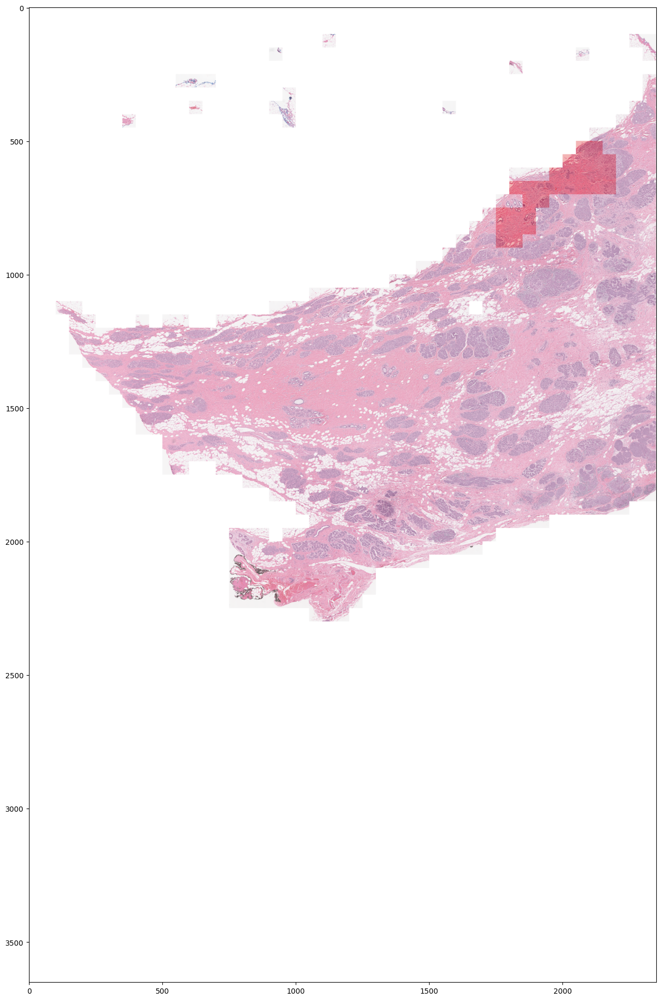

  0%|          | 0/483 [00:00<?, ?it/s]

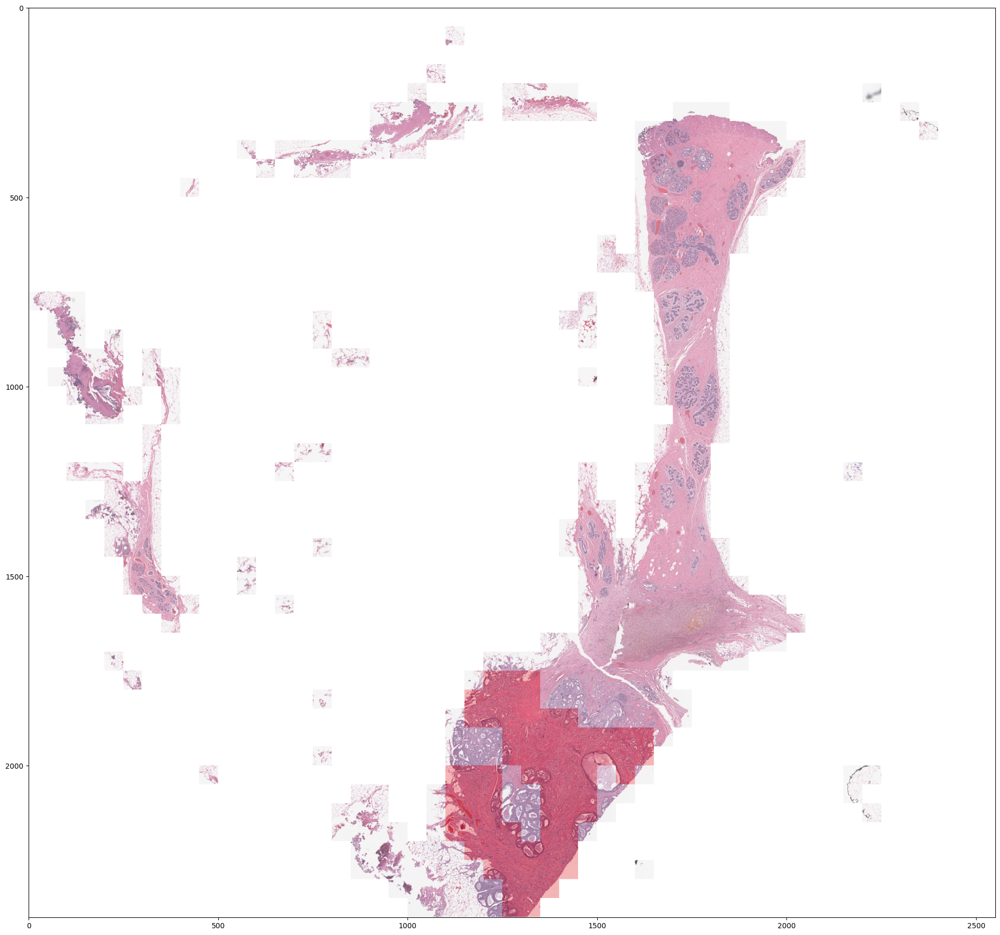

  0%|          | 0/1510 [00:00<?, ?it/s]

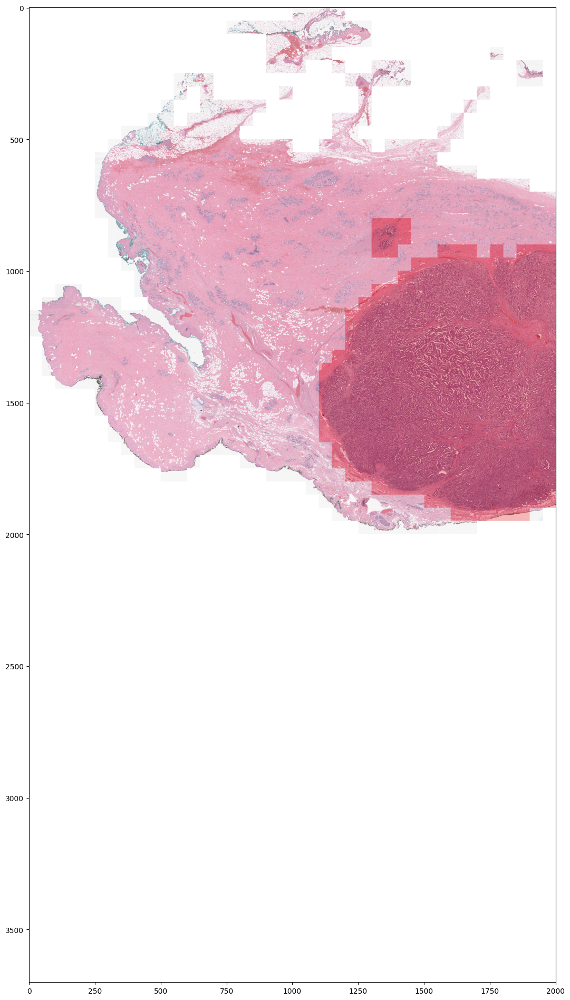

  0%|          | 0/669 [00:00<?, ?it/s]

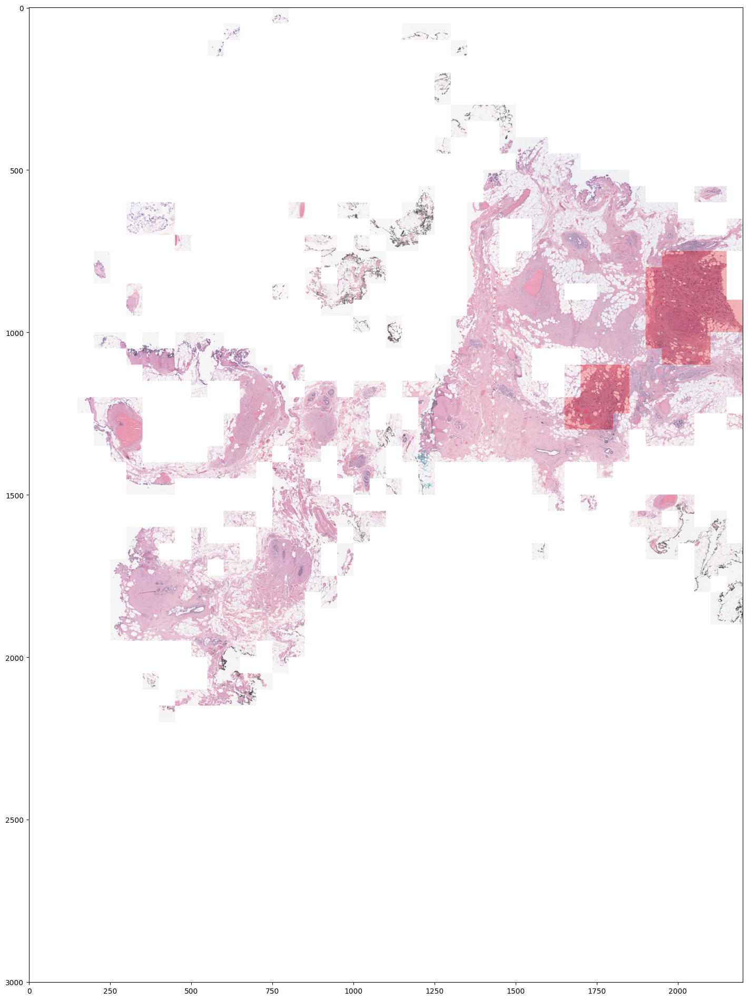

In [5]:
idxs = random.choices(range(len(slides)), k=5)
for idx in idxs:
    slide_viz(create_slide(slides[idx]))
    print()

# Patch Visualization

In [6]:
zeros = list(Path('/kaggle/input/breast-histopathology-images').glob('*/0/*'))
ones = list(Path('/kaggle/input/breast-histopathology-images').glob('*/1/*'))

In [7]:
df = pd.DataFrame({'path':zeros+ones})
df['label'] = df['path'].map(lambda p:int(p.parent.stem))
df['patient'] = df['path'].map(lambda p:p.parent.parent.stem)

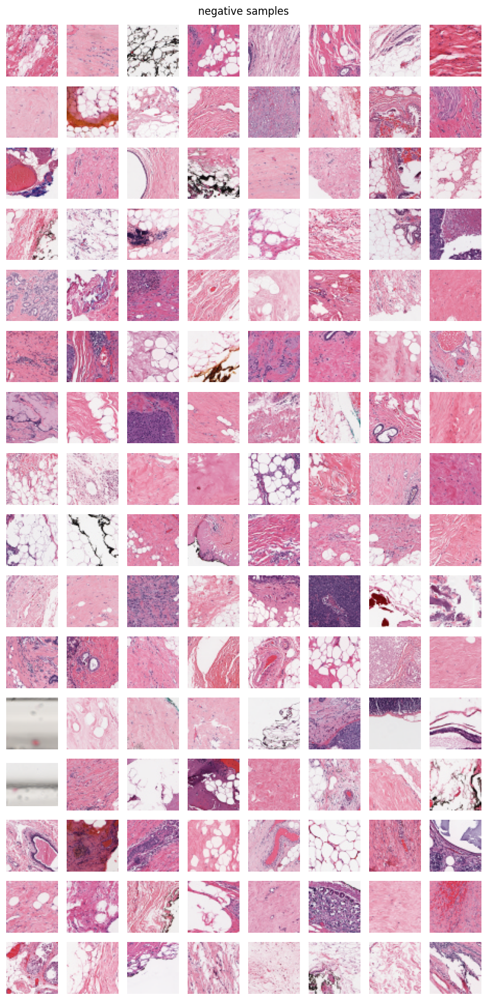

In [8]:
z = df[df['label']==0].sample(n=128)['path']
fig,axs = plt.subplots(16,8,figsize=(8,16),)
axs = axs.flatten()
for i,p in enumerate(z):
    im = Image.open(p).convert('RGB')
    axs[i].imshow(im)
    axs[i].axis('off')
plt.tight_layout()
plt.suptitle('negative samples',y=1.01)
plt.show()

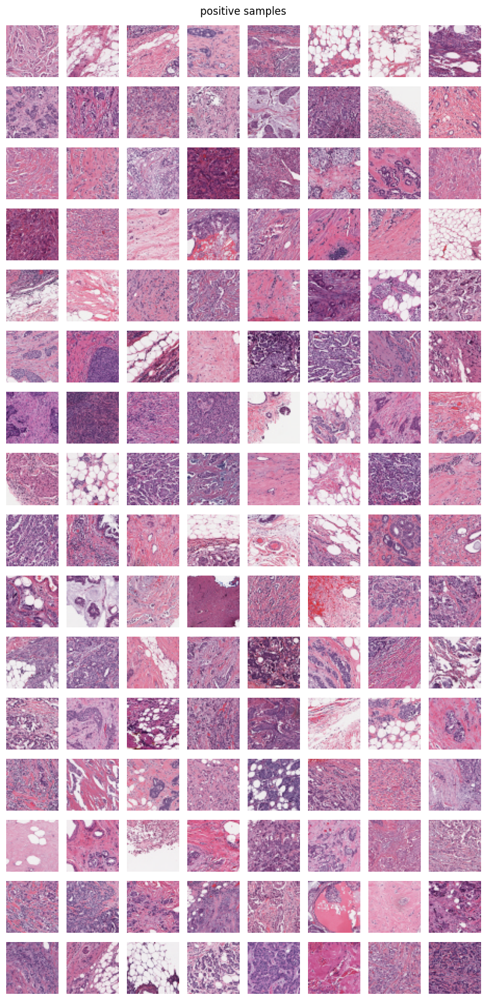

In [9]:
o = df[df['label']==1].sample(n=128)['path']
fig,axs = plt.subplots(16,8,figsize=(8,16),)
axs = axs.flatten()
for i,p in enumerate(o):
    im = Image.open(p).convert('RGB')
    axs[i].imshow(im)
    axs[i].axis('off')
plt.tight_layout()
plt.suptitle('positive samples',y=1.01)
plt.show()

# Comparing Positive and Negative Samples from same patient

In [10]:
def make_grid(p_id, pos, neg):
    
    fig = plt.figure(constrained_layout=True,figsize=(8,4))
    subfigs = fig.subfigures(1,2,wspace=0.2)
    
    for fig_idx, f in enumerate(subfigs.flat):
        images = neg if fig_idx == 0 else pos
        f.suptitle('negative' if fig_idx==0 else 'positive')
        images = [np.array(Image.open(im['path']).convert('RGB')) for im in images]
        axs = f.subplots(4,4)
        for i,ax in enumerate(axs.flatten()):
            ax.imshow(images[i])
            ax.axis('off')
    fig.suptitle(f'patient {p_id}')
    plt.show()
    
def viz_patient(slides, idx):
    patient = get_slices(slides[idx])
    pos = random.choices([sl for sl in patient if sl['label']==1],k=16)
    neg = random.choices([sl for sl in patient if sl['label']==0],k=16)
    p_id = pos[0]['patient_id']
    make_grid(p_id,pos,neg)

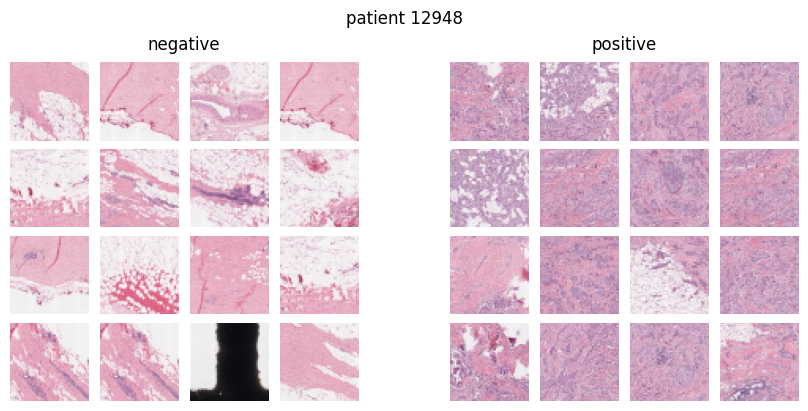

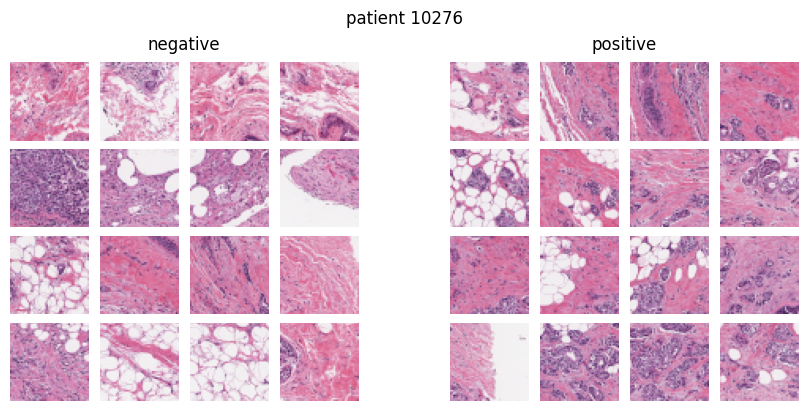

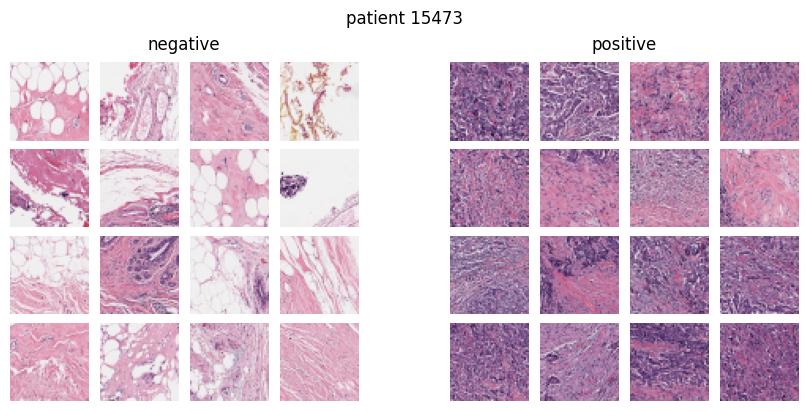

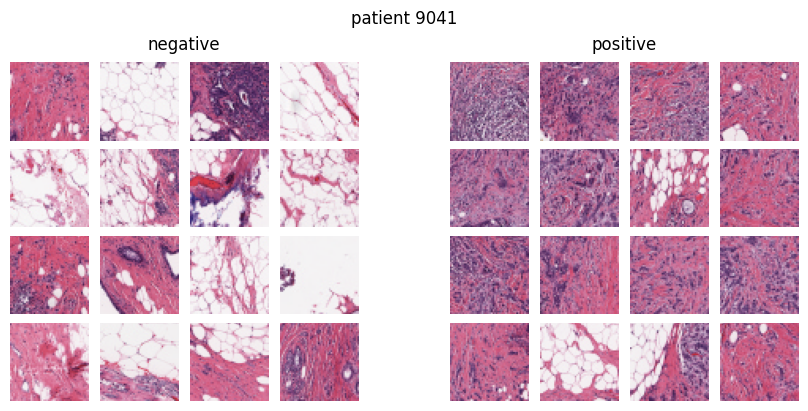

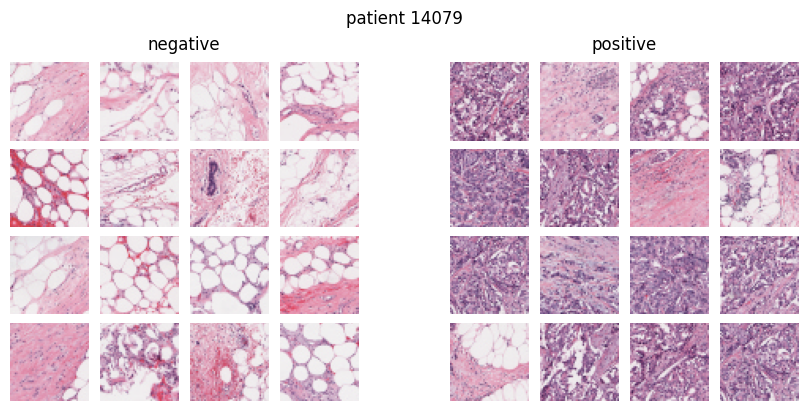

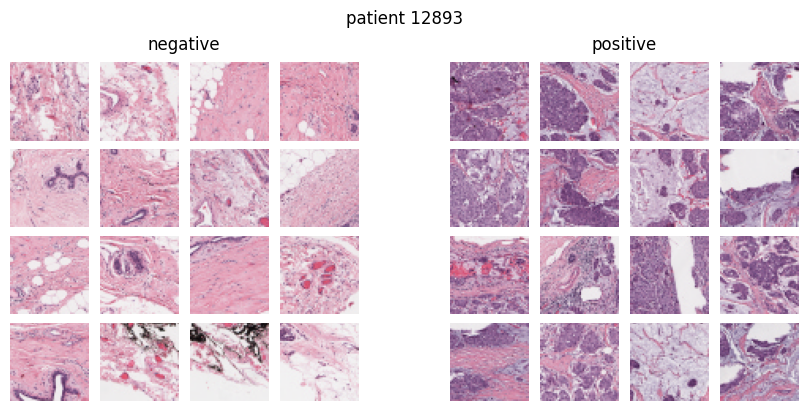

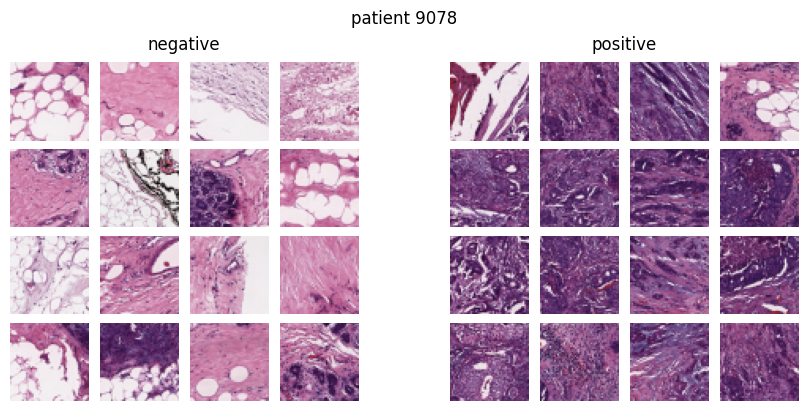

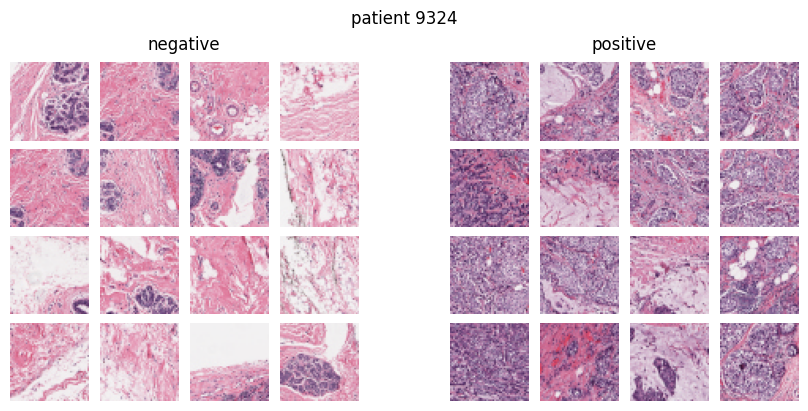

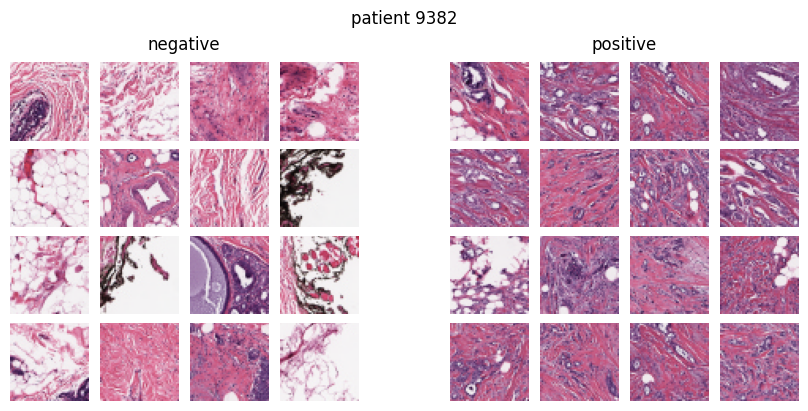

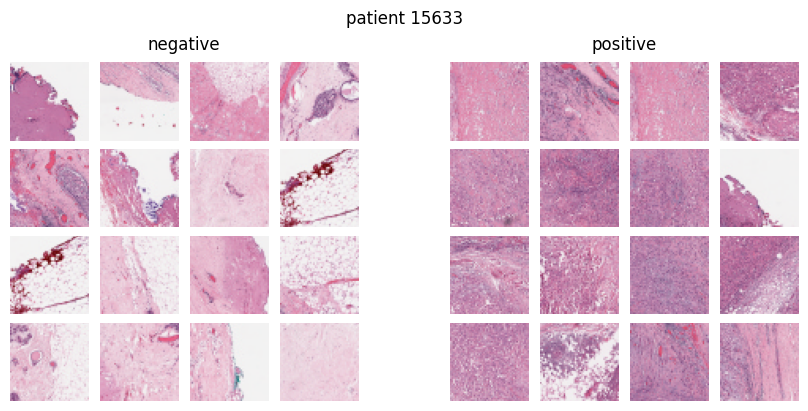

In [11]:
idxs = random.choices(range(len(slides)),k=10)
for idx in idxs:
    viz_patient(slides, idx)
    print()